<a href="https://colab.research.google.com/github/il-ydna/cornerstones/blob/main/Datathon.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import io
import matplotlib.pyplot as plt
import ast

In [ ]:


df = pd.read_csv('/content/drive/MyDrive/Datathon25/p1/places.csv')
df.head()

# change the embeddings from a string to a list
df['embedding'] = df['embedding'].apply(ast.literal_eval)
plt.rcParams['font.family'] = 'DejaVu Sans'

In [ ]:
import warnings
warnings.filterwarnings("ignore", module="matplotlib.font_manager")

# PART 1: Understanding the Places

Some very basic EDA happening here. We just want to see how good the embeddings provided were. We PCA'ed the vector from the 13-dimensional vectors into something we can plot and see (2 dimensions).

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np
import ast

# Load data
print("original vector size: ", len(df.iloc[0]))
X = np.vstack(df['embedding'].values)

# Standardize
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# PCA
pca = PCA(n_components=2)  # Reduce to 2 components
X_pca = pca.fit_transform(X_scaled)


original vector size:  13


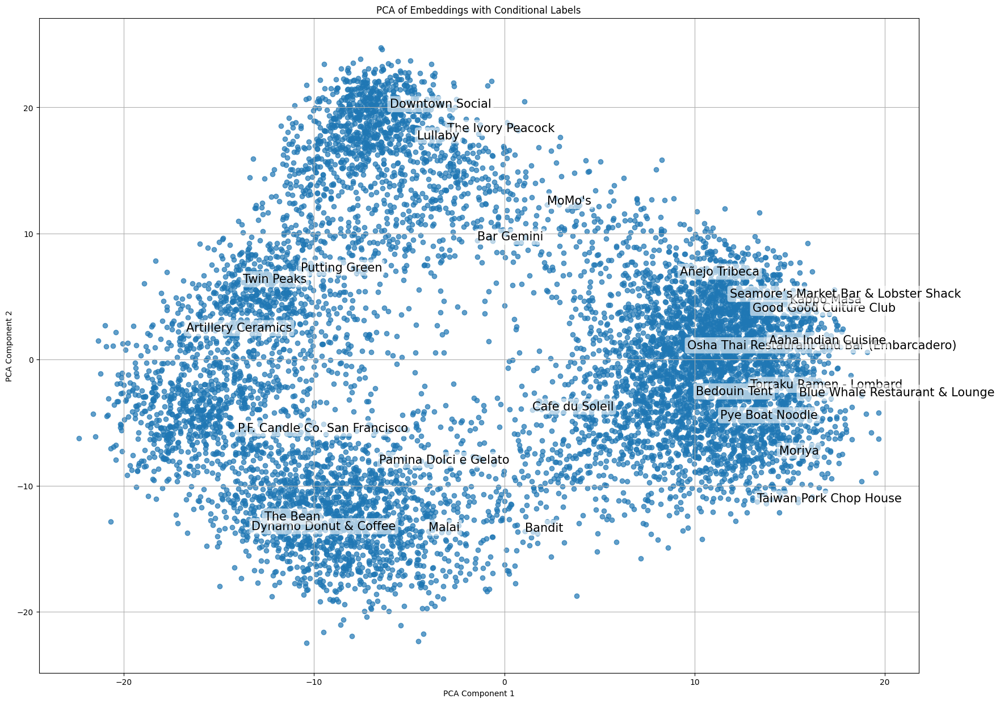

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 15))
plt.scatter(X_pca[:, 0], X_pca[:, 1], alpha=0.7)

# Label every 10th point, excluding names starting with "Place_"
for i in range(0, len(X_pca), 27):
    name = df['name'].iloc[i]
    if not name.startswith('Place_'):
        plt.text(
            X_pca[i, 0],
            X_pca[i, 1],
            name,
            fontsize=15,
            bbox=dict(facecolor='white', alpha=0.6, edgecolor='none', boxstyle='round,pad=0.2')
        )

plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('PCA of Embeddings with Conditional Labels')
plt.grid(True)
plt.show()


tSNE EDA

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Assuming X_scaled is your input data
tsne = TSNE(n_components=2, random_state=42)  # Reduce to 2 dimensions for visualization
X_tsne = tsne.fit_transform(X_scaled)




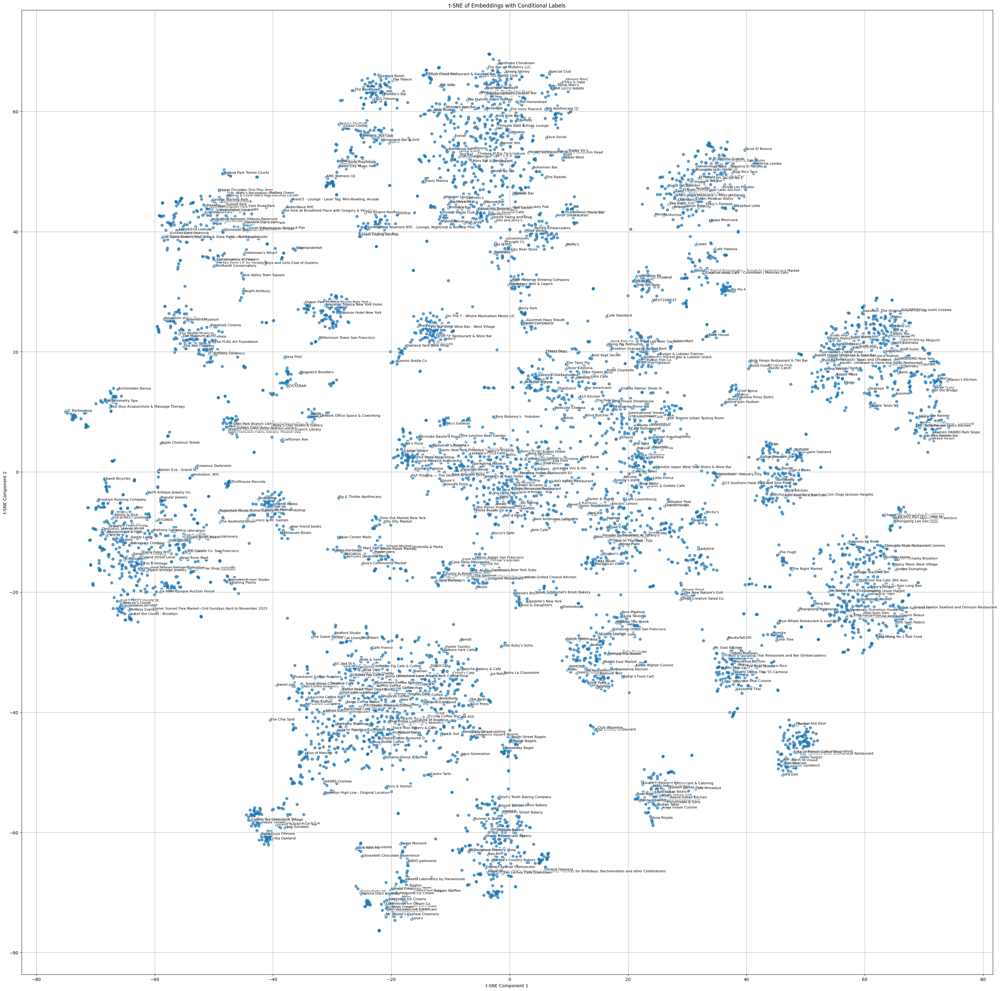

In [ ]:
# Plot t-SNE results
plt.figure(figsize=(40, 40))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], alpha=0.7)

# Label every 10th point, excluding names starting with "Place_"
for i in range(0, len(X_tsne), 1):
    name = df['name'].iloc[i]
    if not name.startswith('Place_'):
        plt.text(
            X_tsne[i, 0],
            X_tsne[i, 1],
            name,
            fontsize=8,
            bbox=dict(facecolor='white', alpha=0.6, edgecolor='none', boxstyle='round,pad=0.2')
        )

plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.title('t-SNE of Embeddings with Conditional Labels')
plt.grid(True)
plt.show()

some clustering on our tSNE dimred

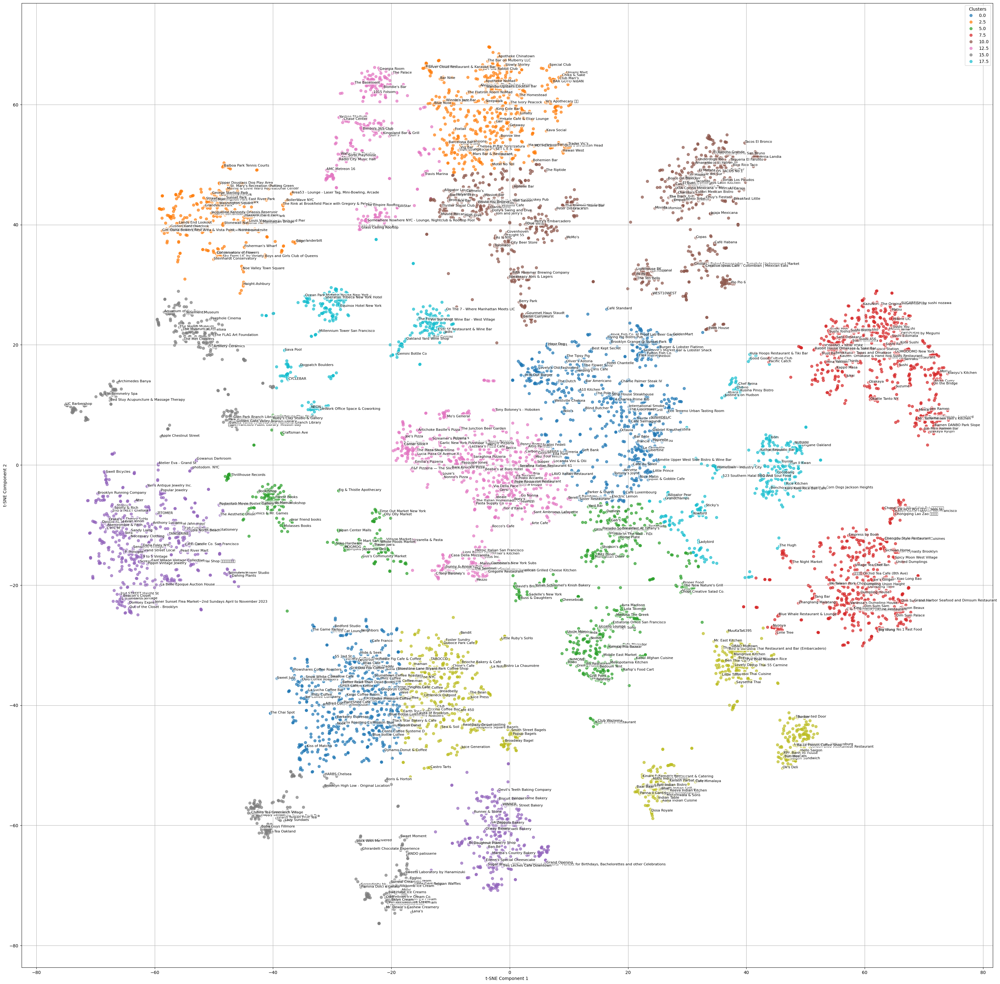

In [ ]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt


# Apply KMeans clustering on the 2D t-SNE data
n_clusters = 20  # You can adjust the number of clusters
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmeans.fit_predict(X_tsne)

# Plot t-SNE results with clustering
plt.figure(figsize=(40, 40))
scatter = plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=clusters, cmap='tab10', alpha=0.7)

# Label every 10th point, excluding names starting with "Place_"
for i in range(0, len(X_tsne), 1):
    name = df['name'].iloc[i]
    if not name.startswith('Place_'):
        plt.text(
            X_tsne[i, 0],
            X_tsne[i, 1],
            name,
            fontsize=8,
            bbox=dict(facecolor='white', alpha=0.6, edgecolor='none', boxstyle='round,pad=0.2')
        )

# Add legend
handles, labels = scatter.legend_elements()
plt.legend(handles, labels, title="Clusters")

plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.grid(True)
plt.show()


Pretty interesting stuff, but we feel that crunching the data space from 13 dimensions to 2 lost us too much information. May be worth changing our k and seeing what different clusters reveal about our places, but that's not what we are after here. We will dimred to a higher dimension (4, to be exact) to see if we can extract meaningful features out of the axes that it will give out. To do this, we will be going with PCA rather than tSNE because of its usefulness even in higher dimensions

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import itertools
import numpy as np

# PCA to 4 dimensions
pca = PCA(n_components=4)
X_pca_4d = pca.fit_transform(X_scaled)

# Normalize the PCA outputs (zero mean, unit variance)
scaler = StandardScaler()
X_pca_4d_normalized = scaler.fit_transform(X_pca_4d)

# Get all combinations of component indices (0, 1, 2, 3)
pairs = list(itertools.combinations(range(4), 2))

print(X_pca_4d_normalized)

# Add normalized PCA components to dataframe
pca_names = ['yum', 'glow', 'spark', 'spice']
for i in range(4):
    df[pca_names[i]] = X_pca_4d_normalized[:, i]

print(df.head())


[[ 1.2057107   0.39769646  0.30136758 -0.75545805]
 [ 1.06228738  0.11597071  0.43065772 -0.84762772]
 [ 0.92428719  0.11090448 -0.18698927  1.61890786]
 ...
 [-0.07451356 -1.28359399 -0.10721318  0.69697639]
 [-0.08071892 -1.67942133 -0.49981359  0.80850704]
 [ 0.31594113 -0.87557018 -0.1897695   0.87149199]]
  place_id                    name  latitude  longitude          tags  \
0  place_1  Good Good Culture Club  37.76236 -122.42219  {restaurant}   
1  place_2                 Place_2  37.75933 -122.41104  {restaurant}   
2  place_3              Penny Roma  37.75973 -122.41012  {restaurant}   
3  place_4                 Place_4  37.79827 -122.42774  {restaurant}   
4  place_5                 Place_5  40.69730  -73.92704         {bar}   

   short_description                                        description emoji  \
0    hawaiian fusion  Hawaiian fusion cuisine with a twist. Perfect ...     🌺   
1      elevated kbbq  Reservations are tough, but worth the effort. ...     🥩   
2     

We run a silhouette test on our data just to see how many clusters would probably be necessary. This enhances a basic kMeans test by computing the best number of clusters, though we may change this later depending on what we decide once we see the data.

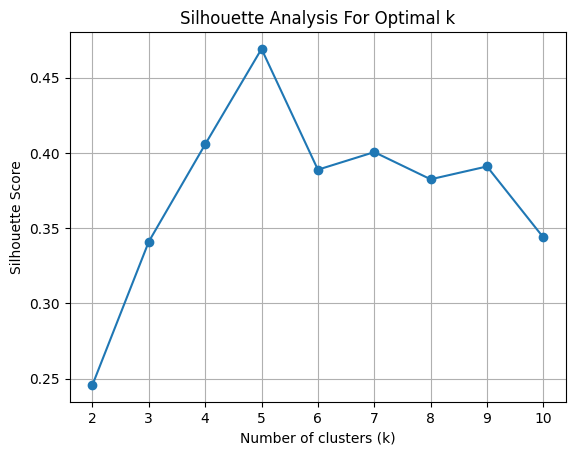

In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Try different k values
range_n_clusters = range(2, 11)
scores = []

for n_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(X_pca_4d_normalized)
    score = silhouette_score(X_pca_4d_normalized, cluster_labels)
    scores.append(score)

# Plot the scores
plt.plot(range_n_clusters, scores, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Analysis For Optimal k')
plt.grid(True)
plt.show()


Here we display the data. We unfortunately can't create a 4D visualization because of our sad monkey minds, but we can create many 2D scatterplots to simulate seeing in 4D and try to find patterns in the data (and through that also find appropriate/catchy names for our dimensions)

Though our silhouette tells us to go with five clusters, we opted for 10. We know that this will result in some blurrier divisions among clusters, but we wanted more classes in our end result for a more diverse array of locales beyond "cafe, restaurant, thrift store, and landmark". It was a deliberate choice on our end to better suit what we think y'all at Corner are interested in.

In [ ]:
import itertools
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.lines import Line2D
from matplotlib import cm

# Assuming the necessary imports for KMeans and X_pca_4d_normalized

kmeans = KMeans(n_clusters=10, random_state=42)
df['cluster'] = kmeans.fit_predict(X_pca_4d_normalized)
unique_labels = sorted(df['cluster'].unique())


pairs = list(itertools.combinations(range(4), 2))
plt.figure(figsize=(70, 50))  # Big but manageable

# Create a colormap for clusters
cmap = plt.get_cmap('tab10')

for i, (x_idx, y_idx) in enumerate(pairs):
    plt.subplot(2, 3, i + 1)

    # Scatter plot with cluster color
    scatter = plt.scatter(
        X_pca_4d_normalized[:, x_idx],
        X_pca_4d_normalized[:, y_idx],
        c=df['cluster'],  # Color based on cluster label
        cmap=cmap,
        alpha=0.6,
        s=40
    )

    # Label every point with the same color as the data point
    for j in range(len(X_pca_4d_normalized)):
        name = df['name'].iloc[j]
        if not name.startswith('Place_'):
            cluster_label = df['cluster'].iloc[j]
            # Correctly map color for label text
            color = cmap(cluster_label / (len(unique_labels) - 1))  # Map cluster label to colormap
            plt.text(
                X_pca_4d_normalized[j, x_idx] + 0.05,  # slight offset
                X_pca_4d_normalized[j, y_idx] + 0.05,
                name,
                fontsize=7,
                color=color,
                bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.1')
            )

    plt.xlabel(f'PCA {x_idx+1}', fontsize=12)
    plt.ylabel(f'PCA {y_idx+1}', fontsize=12)
    plt.title(f'PCA {x_idx+1} vs PCA {y_idx+1}', fontsize=14)
    plt.grid(True)

# Create the custom legend for clusters
unique_labels = sorted(df['cluster'].unique())
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=cmap(label / (len(unique_labels) - 1)), markersize=10, label=f'Cluster {label}')
           for label in unique_labels]

plt.legend(handles=handles, title="Clusters", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


We tried a DBSCAN to see if there were any obvious non-linear relationships in our data that PCA could have missed, but it yielded similar clusters. For efficiency's sake, we will continue using PCA. Good to have this alternative clustering here, though!

In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Optional: scale your data (important for DBSCAN)
X_scaled = StandardScaler().fit_transform(X_pca_4d_normalized)

# Run DBSCAN
dbscan = DBSCAN(eps=0.3, min_samples=10)  # You can tweak these
dbscan_labels = dbscan.fit_predict(X_scaled)

# Assign labels to DataFrame
df['dbscan_cluster'] = dbscan_labels



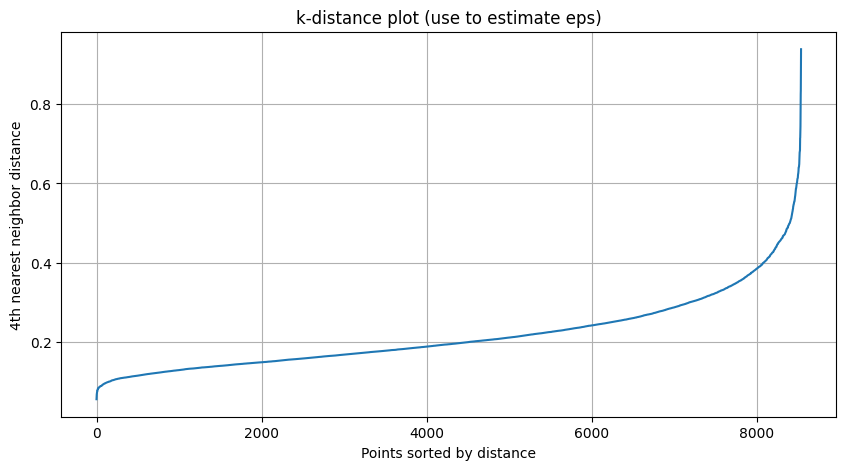

In [ ]:
from sklearn.neighbors import NearestNeighbors
import numpy as np
import matplotlib.pyplot as plt

# You typically use min_samples = 4 or higher for the k-distance
k = 4
nbrs = NearestNeighbors(n_neighbors=k).fit(X_scaled)
distances, indices = nbrs.kneighbors(X_scaled)

# Take the distance to the kth nearest neighbor
k_distances = np.sort(distances[:, k-1])

plt.figure(figsize=(10, 5))
plt.plot(k_distances)
plt.ylabel(f"{k}th nearest neighbor distance")
plt.xlabel("Points sorted by distance")
plt.title("k-distance plot (use to estimate eps)")
plt.grid(True)
plt.show()


just plotting out the DBSCAN clusters below

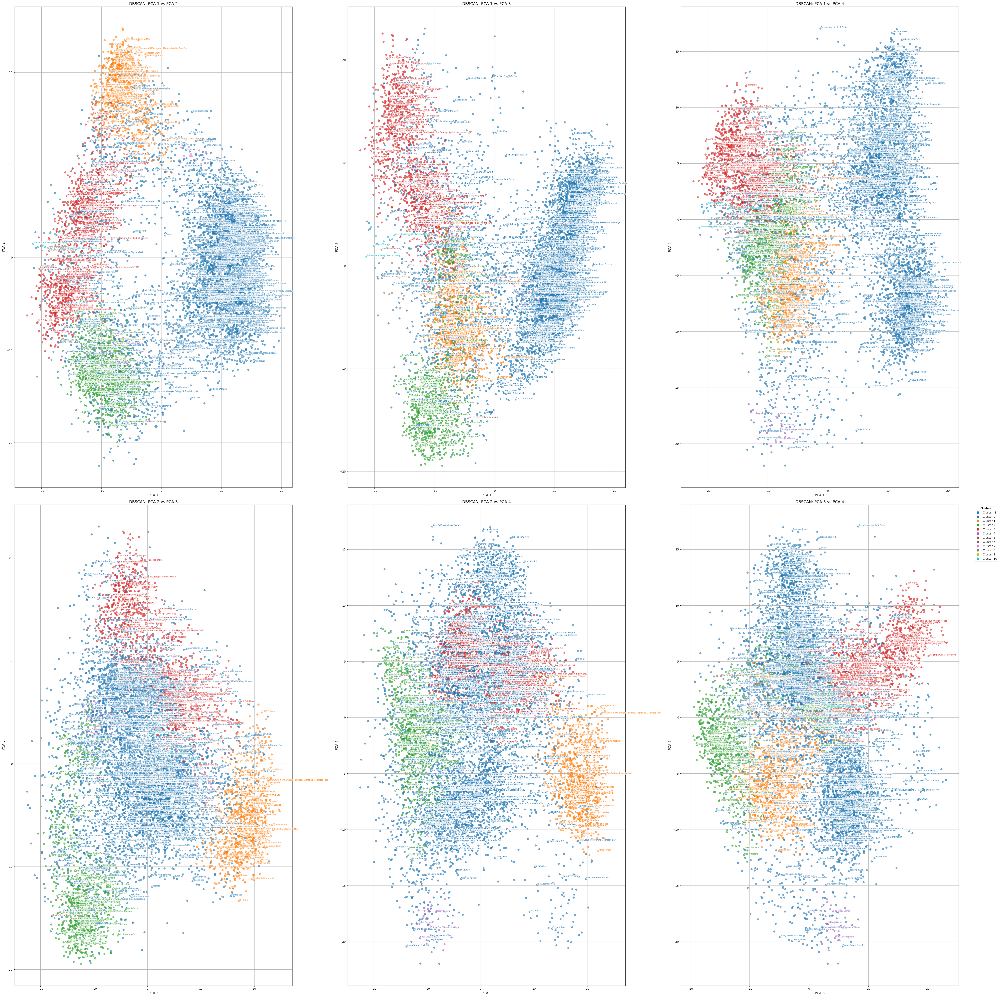

In [ ]:
import itertools
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.lines import Line2D

import warnings
warnings.filterwarnings("ignore")

pairs = list(itertools.combinations(range(4), 2))
plt.figure(figsize=(50, 50))

# Get the colormap and normalize cluster labels to it
cmap = cm.get_cmap('tab10')
unique_labels = sorted(df['dbscan_cluster'].unique())
label_to_color = {label: cmap(i / len(unique_labels)) for i, label in enumerate(unique_labels)}

for i, (x_idx, y_idx) in enumerate(pairs):
    plt.subplot(2, 3, i + 1)

    # Scatter plot
    scatter = plt.scatter(
        X_pca_4d[:, x_idx],
        X_pca_4d[:, y_idx],
        c=df['dbscan_cluster'].map(label_to_color),
        alpha=0.6,
        s=40
    )

    # Text labels matching cluster color
    for j in range(len(X_pca_4d)):
        name = df['name'].iloc[j]
        if not name.startswith('Place_'):
            cluster_label = df['dbscan_cluster'].iloc[j]
            color = label_to_color[cluster_label]
            plt.text(
                X_pca_4d[j, x_idx] + 0.05,
                X_pca_4d[j, y_idx] + 0.05,
                name,
                fontsize=7,
                color=color,
                bbox=dict(facecolor='white', alpha=0.7, edgecolor='none', boxstyle='round,pad=0.1')
            )

    plt.xlabel(f'PCA {x_idx+1}', fontsize=12)
    plt.ylabel(f'PCA {y_idx+1}', fontsize=12)
    plt.title(f'DBSCAN: PCA {x_idx+1} vs PCA {y_idx+1}', fontsize=14)
    plt.grid(True)

# Create the custom legend
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=f'Cluster {label}')
           for label, color in label_to_color.items()]
plt.legend(handles=handles, title="Clusters", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()


# PART 2: CREATING PROFILES OF EACH USER

We weren't given much information to identify each user outside of the posts they've made, which means we are faced with the challenge of creating profiles that can represent each user based solely on these posts. We're going to be using the dimensions we analyzed above to quantify people's personalities.

By seeing what kinds of places people want to visit, have visited and loved, and have visited and hated we can get a pretty good sense of what kind of person they are.

In [ ]:
#loading data

users = pd.read_csv('/content/drive/MyDrive/Datathon25/p1/users.csv')
posts = pd.read_csv('/content/drive/MyDrive/Datathon25/p1/user_place.csv')
places = df

print(users.head())
print(posts.head())
print(df.head())
print(df.columns)


  user_id
0  user_1
1  user_2
2  user_3
3  user_4
4  user_5
  user_id   place_id   status
0  user_1    place_1  visited
1  user_1    place_2      fav
2  user_1  place_440  visited
3  user_1  place_667  visited
4  user_1  place_668  visited
  place_id                    name  latitude  longitude          tags  \
0  place_1  Good Good Culture Club  37.76236 -122.42219  {restaurant}   
1  place_2                 Place_2  37.75933 -122.41104  {restaurant}   
2  place_3              Penny Roma  37.75973 -122.41012  {restaurant}   
3  place_4                 Place_4  37.79827 -122.42774  {restaurant}   
4  place_5                 Place_5  40.69730  -73.92704         {bar}   

   short_description                                        description emoji  \
0    hawaiian fusion  Hawaiian fusion cuisine with a twist. Perfect ...     🌺   
1      elevated kbbq  Reservations are tough, but worth the effort. ...     🥩   
2     homemade pasta  Open windows and intimate setting create a rom...     🍝 

this is where we calculate each user's vibe scores. We took a weighted average of their ratings

In [ ]:
import pandas as pd

# Define weights for post statuses
status_weights = {
    'fav': 1,
    'visited': 0.5,
    'want to try': 0.2,
    'dislike': -1
}

print(posts['status'].unique())
print(posts['status'].value_counts(normalize=True))

# Map post statuses to weights
posts['weight'] = posts['status'].map(status_weights)

# Merge posts with PCA data from places
posts_with_pca = posts.merge(
    places[['place_id', 'yum', 'glow', 'spark', 'spice']],
    on='place_id'
)

# Multiply each PCA component by the weight
for col in ['yum', 'glow', 'spark', 'spice']:
    posts_with_pca[f'{col}_weighted'] = posts_with_pca[col] * posts_with_pca['weight']

# Group by user and compute weighted averages + post count
user_stats = posts_with_pca.groupby('user_id').agg(
    total_weight=('weight', 'sum'),
    num_posts=('place_id', 'count'),
    yum_sum=('yum_weighted', 'sum'),
    glow_sum=('glow_weighted', 'sum'),
    spark_sum=('spark_weighted', 'sum'),
    spice_sum=('spice_weighted', 'sum')
).reset_index()

# Compute weighted averages (avoid division by zero)
for col in ['yum', 'glow', 'spark', 'spice']:
    user_stats[col] = user_stats[f'{col}_sum'] / user_stats['total_weight']

# Keep only relevant columns
user_stats = user_stats[['user_id', 'num_posts', 'yum', 'glow', 'spark', 'spice']]

# Merge into users_df
users = users.merge(user_stats, on='user_id', how='left')

print(users.head(15))


['visited' 'fav' 'dislike' 'want to try' nan]
status
want to try    0.504728
visited        0.430448
fav            0.059031
dislike        0.005792
Name: proportion, dtype: float64
    user_id  num_posts       yum      glow     spark     spice
0    user_1         21  0.183410 -0.317365 -0.695605  0.290686
1    user_2         53  0.447206  0.420928 -0.168786 -0.011044
2    user_3         16  0.485736  0.954555  0.047435 -0.002371
3    user_4         33 -0.505968  0.807246 -0.388666 -0.169367
4    user_5         19 -0.530816  1.101972 -0.385155 -0.359635
5    user_6         23 -0.539449  0.862162 -0.083804 -0.113744
6    user_7        227  0.173678  0.433184 -0.057592 -0.144019
7    user_8         40 -0.200998 -0.609006 -0.306269  0.388392
8    user_9        103  0.880678  0.000911  0.020076  0.053686
9   user_10         14  0.336403 -0.453681 -0.217105  0.681793
10  user_11        183  0.121475  0.304157 -0.452741  0.160413
11  user_12         38  0.409180  0.578391 -0.062183 -0.694505

Here we're encoding our vibe scores into something interpretable (and fun to share), our personality types!

In [ ]:
for col in ['yum', 'glow', 'spark', 'spice']:
  users[f'{col}_bool'] = users[col] > 0
def encode_personality(row):
    code = ''
    code += 'B' if row['yum_bool'] else 'R'
    code += 'M' if row['glow_bool'] else 'S'
    code += 'A' if row['spark_bool'] else 'R'
    code += 'L' if row['spice_bool'] else 'C'
    return code

users['personality'] = users.apply(encode_personality, axis=1)

print(users[['yum', 'glow', 'spark', 'spice', 'personality']].head(15))

print(users.sort_values(by='num_posts',ascending=False).head)

         yum      glow     spark     spice personality
0   0.183410 -0.317365 -0.695605  0.290686        BSRL
1   0.447206  0.420928 -0.168786 -0.011044        BMRC
2   0.485736  0.954555  0.047435 -0.002371        BMAC
3  -0.505968  0.807246 -0.388666 -0.169367        RMRC
4  -0.530816  1.101972 -0.385155 -0.359635        RMRC
5  -0.539449  0.862162 -0.083804 -0.113744        RMRC
6   0.173678  0.433184 -0.057592 -0.144019        BMRC
7  -0.200998 -0.609006 -0.306269  0.388392        RSRL
8   0.880678  0.000911  0.020076  0.053686        BMAL
9   0.336403 -0.453681 -0.217105  0.681793        BSRL
10  0.121475  0.304157 -0.452741  0.160413        BMRL
11  0.409180  0.578391 -0.062183 -0.694505        BMRC
12 -0.517844 -0.008295  0.000939  0.259260        RSAL
13 -0.058276 -0.523918 -0.205956 -0.320270        RSRC
14 -0.989985 -0.082131  0.341985 -0.042710        RSAC
<bound method NDFrame.head of       user_id  num_posts       yum      glow     spark     spice  yum_bool  \
800  user_80

In [ ]:
# Count number of users for each personality type
personality_counts = users['personality'].value_counts()

print(personality_counts)


personality
RMRC    178
BMRL    109
RSRC    109
BSAC    101
BSRC    100
RMAL     99
BMRC     95
BSRL     88
RMRL     88
RSRL     70
BMAC     55
RSAL     55
RMAC     48
RSAC     45
BSAL     18
BMAL     17
Name: count, dtype: int64


In [ ]:
from sklearn.preprocessing import StandardScaler

# Normalize the user scores
scaler = StandardScaler()
users_scaled_features = scaler.fit_transform(users[['yum', 'glow', 'spark', 'spice']])

# Put them back into the dataframe
users[['yum', 'glow', 'spark', 'spice']] = users_scaled_features

print(users.head(15))

    user_id  num_posts       yum      glow     spark     spice  yum_bool  \
0    user_1         21  0.527794 -0.776268 -1.363032  0.922990      True   
1    user_2         53  1.086914  0.632802 -0.104477  0.130379      True   
2    user_3         16  1.168577  1.651256  0.412070  0.153162      True   
3    user_4         33 -0.933348  1.370110 -0.629763 -0.285517     False   
4    user_5         19 -0.986014  1.932610 -0.621376 -0.785330     False   
5    user_6         23 -1.004313  1.474919  0.098543 -0.139403     False   
6    user_7        227  0.507167  0.656194  0.161162 -0.218931      True   
7    user_8         40 -0.286962 -1.332878 -0.432920  1.179654     False   
8    user_9        103  2.005661 -0.168821  0.346711  0.300419      True   
9   user_10         14  0.852065 -1.036432 -0.219908  1.950386      True   
10  user_11        183  0.396523  0.409939 -0.782837  0.580779      True   
11  user_12         38  1.006316  0.933328  0.150196 -1.664996      True   
12  user_13 

In [ ]:
print(users.sort_values(by=['num_posts'], ascending=False))

      user_id  num_posts       yum      glow     spark     spice  yum_bool  \
800  user_801        854 -0.111597 -0.109191  0.372351  0.110226     False   
596  user_597        826 -0.258764 -0.494081  0.084162  0.112612     False   
467  user_468        654 -0.143570  0.417782 -0.411640 -0.196356     False   
612  user_613        650  0.048120  0.226754 -0.053487 -0.303802     False   
31    user_32        581  0.357982 -0.106689  0.747117 -0.274768      True   
..        ...        ...       ...       ...       ...       ...       ...   
544  user_545         10  0.916096 -1.278165  0.033660 -0.875302      True   
778  user_779         10 -0.334252 -0.431298  2.471839  0.074034     False   
498  user_499          9 -1.018505 -0.730518  0.216894 -0.013774     False   
104  user_105          8 -1.419933  1.123293  2.594626  1.532246     False   
494  user_495          7  1.987779 -0.922838  0.906771 -1.373673      True   

     glow_bool  spark_bool  spice_bool personality  
800       

We were careful to match the dimensions and the normalization methods between our user vibes and our location vibes, which lets us slot our users into clusters too! This is where we can see what kinds of restaurants to push onto whom, as well as which people are most similar to each other!

In [ ]:
from scipy.spatial.distance import cdist
import numpy as np

# Get the cluster centers from KMeans (already trained on restaurants)
restaurant_cluster_centers = kmeans.cluster_centers_

# Get users' normalized yum, glow, spark, spice vectors
user_vectors = users[['yum', 'glow', 'spark', 'spice']].values

# Compute distances between each user and each restaurant cluster center
distances = cdist(user_vectors, restaurant_cluster_centers, metric='euclidean')

# For each user, find the nearest cluster
users['assigned_cluster'] = np.argmin(distances, axis=1)



In [ ]:

print(users.columns)
print(places.columns)

user_cluster_counts = users['assigned_cluster'].value_counts()
for col in ['yum', 'glow', 'spark', 'spice']:
  print(users[f'{col}_bool'].value_counts(normalize=True))

# Method 1: groupby and value_counts
personality_distribution = users.groupby('assigned_cluster')['personality'].value_counts().unstack(fill_value=0)

print(personality_distribution)



Index(['user_id', 'num_posts', 'yum', 'glow', 'spark', 'spice', 'yum_bool',
       'glow_bool', 'spark_bool', 'spice_bool', 'personality',
       'assigned_cluster'],
      dtype='object')
Index(['place_id', 'name', 'latitude', 'longitude', 'tags',
       'short_description', 'description', 'emoji', 'key_words', 'city',
       'postal_code', 'neighborhood', 'embedding', 'yum', 'glow', 'spark',
       'spice', 'cluster', 'dbscan_cluster'],
      dtype='object')
yum_bool
False    0.542745
True     0.457255
Name: proportion, dtype: float64
glow_bool
True     0.540392
False    0.459608
Name: proportion, dtype: float64
spark_bool
False    0.656471
True     0.343529
Name: proportion, dtype: float64
spice_bool
False    0.573333
True     0.426667
Name: proportion, dtype: float64
personality       BMAC  BMAL  BMRC  BMRL  BSAC  BSAL  BSRC  BSRL  RMAC  RMAL  \
assigned_cluster                                                               
0                    0     0     0     0     0     0     6

Last but not least, we wanted to show you what our users' vibes look like over the backdrop of the locations they posted about. Take a look!

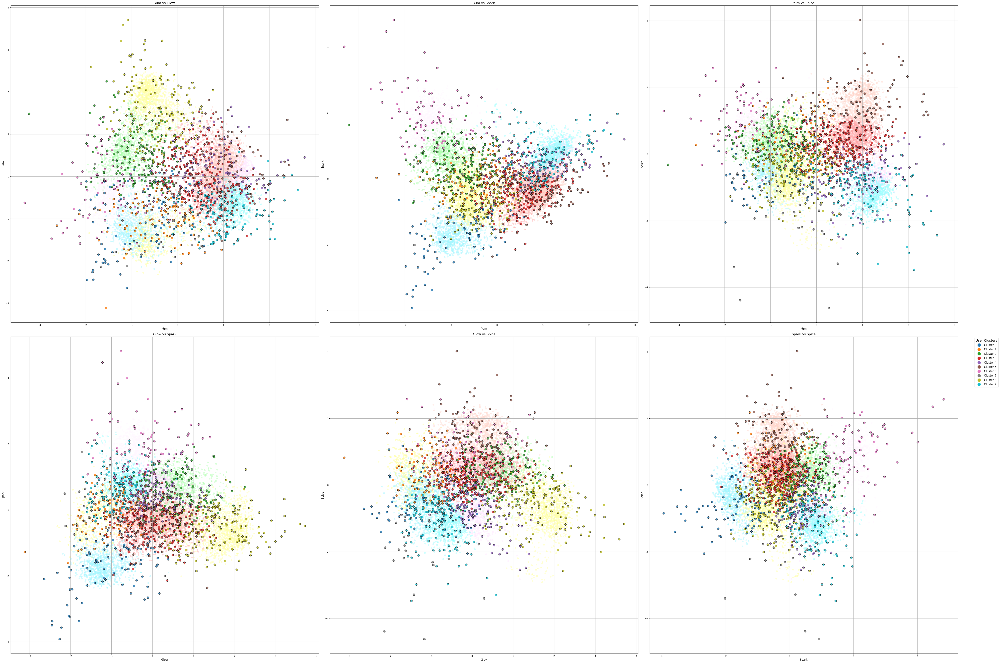

In [ ]:
import itertools
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm
from matplotlib.lines import Line2D

# Define the features to compare
features = ['yum', 'glow', 'spark', 'spice']
pairs = list(itertools.combinations(features, 2))

# Set up color maps
cmap = cm.get_cmap('tab10')
unique_clusters = sorted(users['assigned_cluster'].unique())

# Create a mapping from cluster to color
cluster_to_color = {cluster: cmap(i / max(len(unique_clusters)-1, 1)) for i, cluster in enumerate(unique_clusters)}

# Create the plots
plt.figure(figsize=(60, 40))  # Big enough for 6 subplots

for idx, (feat_x, feat_y) in enumerate(pairs):
    plt.subplot(2, 3, idx + 1)

    # Plot place points (less vibrant)
    for cluster in unique_clusters:
        places_in_cluster = places[places['cluster'] == cluster]
        color = cluster_to_color[cluster]
        # faded_color = color
        faded_color = tuple(np.clip(np.array(color) + 0.5, 0, 1))  # lighten color
        plt.scatter(
            places_in_cluster[feat_x],
            places_in_cluster[feat_y],
            c=[faded_color],
            alpha=0.4,
            s=40
        )

    # Plot user points (vibrant)
    for cluster in unique_clusters:
        users_in_cluster = users[users['assigned_cluster'] == cluster]
        color = cluster_to_color[cluster]
        plt.scatter(
            users_in_cluster[feat_x],
            users_in_cluster[feat_y],
            c=[color],
            alpha=0.8,
            s=80,
            edgecolor='black'
        )

    plt.xlabel(feat_x.capitalize(), fontsize=12)
    plt.ylabel(feat_y.capitalize(), fontsize=12)
    plt.title(f'{feat_x.capitalize()} vs {feat_y.capitalize()}', fontsize=14)
    plt.grid(True)

# Build a custom legend manually
legend_elements = [
    Line2D(
        [0], [0],
        marker='o', color='w', label=f'Cluster {cluster}',
        markerfacecolor=color, markersize=15
    )
    for cluster, color in cluster_to_color.items()
]

plt.legend(
    handles=legend_elements,
    title='User Clusters',
    bbox_to_anchor=(1.05, 1),
    loc='upper left',
    fontsize=12,
    title_fontsize=14
)

plt.tight_layout()
plt.show()
